<h1><center> Assignment 1 </center></h1>



<h2><center> Data Loading and Pre-processing </center></h2>

The first stage of data pre-processing consists in loading the data from the original data set and loading it into a dataframe

In [1]:
import os
import pandas as pd
import numpy as np

# Here you will add your own directory to the source files
general_dir = os.path.join("..","Assignment1","DATA", "TXT") 

# Loops through the files ignoring the hidden ones and adding the speeches to a df
data=[]
for dirname in os.listdir(general_dir):
    if dirname[0]==".": #ignore hidden files
        continue
    for filename in os.listdir(os.path.join(general_dir, dirname)):
        session = int(dirname.split(" ")[1])
        directory = os.path.join(general_dir, dirname)
        if filename[0]==".": #ignore hidden files
            continue
        with open(os.path.join(directory, filename), "r", encoding='utf-8') as f:
            splt = filename.split("_")
            try:
                data.append([session, 1945+session, splt[0], f.read()])
            except:
                print(f"Error reading file {filename} in session {session}")


df_raw = pd.DataFrame(data, columns=["session", "year", "speaker", "text"])
df_raw.head()

,session,year,speaker,text
0,1,1946,ARG,At the resumption of the first session of the ...
1,1,1946,AUS,The General Assembly of the United Nations is ...
2,1,1946,BEL,The\tprincipal organs of the United Nations ha...
3,1,1946,BLR,As more than a year has elapsed since the Unit...
4,1,1946,BOL,Coming to this platform where so many distingu...


After having the data frame with the speeches from every country we can now treat each speach, simplifying the text resorting to NLP techniques like removing poctuation, lowecasing, removing stopwords and stemming

In [2]:
import nltk
import string
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
nltk.download('punkt_tab')
nltk.download('stopwords')

# First we turn the text into lowercases only
df_clean = df_raw
df_clean["text"] = df_raw["text"].apply(lambda x: x.lower())

# Secondly we clear the text of any ponctuation
def clean_text(text):
    tokens = word_tokenize(text)
    tokens_no_punct = [word for word in tokens if word not in string.punctuation]
    return " ".join(tokens_no_punct)

df_clean['cleaned_text'] = df_clean['text'].apply(clean_text)
print(df_clean['cleaned_text'].head())

# Thirdly we remove the stopwords
stop_words = set(stopwords.words('english'))

def remove_stopwords(sentence):
    words = sentence.split()  # Split string into words
    filtered_words = [word for word in words if word not in stop_words]
    return ' '.join(filtered_words)  # Return string without stopwords

df_clean['text_no_stopwords'] = df_clean['cleaned_text'].apply(remove_stopwords)
print(df_clean['text_no_stopwords'].head())

# Finally we stem all the words in the text
stemmer = PorterStemmer()

def stem_sentence(sentence):
    words = sentence.split()  # split string into words
    stemmed_words = [stemmer.stem(word) for word in words]  # stem each word
    return ' '.join(stemmed_words)  # rejoin into string

df_clean['text_stemmed'] = df_clean['text_no_stopwords'].apply(stem_sentence)
df_clean.head()

[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\jtfb7\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\jtfb7\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


0    at the resumption of the first session of the ...
1    the general assembly of the united nations is ...
2    the principal organs of the united nations hav...
3    as more than a year has elapsed since the unit...
4    coming to this platform where so many distingu...
Name: cleaned_text, dtype: object
0    resumption first session general assembly arge...
1    general assembly united nations meeting time h...
2    principal organs united nations functioning ne...
3    year elapsed since united nations charter sign...
4    coming platform many distinguished eloquent sp...
Name: text_no_stopwords, dtype: object


,session,year,speaker,text,cleaned_text,text_no_stopwords,text_stemmed
0,1,1946,ARG,at the resumption of the first session of the ...,at the resumption of the first session of the ...,resumption first session general assembly arge...,resumpt first session gener assembl argentin d...
1,1,1946,AUS,the general assembly of the united nations is ...,the general assembly of the united nations is ...,general assembly united nations meeting time h...,gener assembl unit nation meet time hospit cit...
2,1,1946,BEL,the\tprincipal organs of the united nations ha...,the principal organs of the united nations hav...,principal organs united nations functioning ne...,princip organ unit nation function nearli nine...
3,1,1946,BLR,as more than a year has elapsed since the unit...,as more than a year has elapsed since the unit...,year elapsed since united nations charter sign...,year elaps sinc unit nation charter sign san f...
4,1,1946,BOL,coming to this platform where so many distingu...,coming to this platform where so many distingu...,coming platform many distinguished eloquent sp...,come platform mani distinguish eloqu speaker p...


Additionally we set a Multi-index for the dataframe consisting of the speaker and year of the event

In [4]:
df_clean.set_index(["speaker","year"],inplace=True)
df_clean.head()

,,session,text,cleaned_text,text_no_stopwords,text_stemmed
speaker,year,,,,,
ARG,1946,1,at the resumption of the first session of the ...,at the resumption of the first session of the ...,resumption first session general assembly arge...,resumpt first session gener assembl argentin d...
AUS,1946,1,the general assembly of the united nations is ...,the general assembly of the united nations is ...,general assembly united nations meeting time h...,gener assembl unit nation meet time hospit cit...
BEL,1946,1,the\tprincipal organs of the united nations ha...,the principal organs of the united nations hav...,principal organs united nations functioning ne...,princip organ unit nation function nearli nine...
BLR,1946,1,as more than a year has elapsed since the unit...,as more than a year has elapsed since the unit...,year elapsed since united nations charter sign...,year elaps sinc unit nation charter sign san f...
BOL,1946,1,coming to this platform where so many distingu...,coming to this platform where so many distingu...,coming platform many distinguished eloquent sp...,come platform mani distinguish eloqu speaker p...


We load one of the datasets, in this case the Rule of Law index dataset

In [28]:
df_rol = pd.read_csv(os.path.join("DATA", "ruleoflaw_dataset.csv"),sep=",")
df_rol.head()

,Series Name,Series Code,Country Name,Country Code,1996 [YR1996],1998 [YR1998],2000 [YR2000],2002 [YR2002],2003 [YR2003],2004 [YR2004],...,2014 [YR2014],2015 [YR2015],2016 [YR2016],2017 [YR2017],2018 [YR2018],2019 [YR2019],2020 [YR2020],2021 [YR2021],2022 [YR2022],2023 [YR2023]
0,Rule of Law: Estimate,RL.EST,Afghanistan,AFG,-1.78807544708252,-1.73488676548004,-1.78066074848175,-1.67347323894501,-1.5582937002182,-1.6939252614975,...,-1.4377019405365,-1.51620066165924,-1.52253365516663,-1.58117640018463,-1.68912386894226,-1.74210047721863,-1.83140671253204,-1.87723398208618,-1.65984559059143,-1.64964091777802
1,Rule of Law: Estimate,RL.EST,Albania,ALB,-0.684481799602509,-0.929671704769135,-1.02066767215729,-0.762321412563324,-0.716323494911194,-0.701032340526581,...,-0.311199098825455,-0.31968680024147,-0.322631984949112,-0.414191573858261,-0.414752036333084,-0.426317363977432,-0.378028213977814,-0.280716270208359,-0.165585100650787,-0.164097368717194
2,Rule of Law: Estimate,RL.EST,Algeria,DZA,-1.21819484233856,-1.19836211204529,-1.24584436416626,-0.636733174324036,-0.605380773544312,-0.616287350654602,...,-0.804650962352753,-0.941968441009521,-0.916658818721771,-0.925012648105621,-0.806978523731232,-0.861034154891968,-0.798027575016022,-0.833022832870483,-0.833259999752045,-0.678364396095276
3,Rule of Law: Estimate,RL.EST,American Samoa,ASM,..,..,..,..,..,0.839596450328827,...,1.40731287002563,1.28552782535553,1.27915823459625,1.29530119895935,1.29659616947174,1.26820170879364,1.118488073349,1.13875997066498,1.22111594676971,1.21249115467072
4,Rule of Law: Estimate,RL.EST,Andorra,AND,1.15836250782013,1.17725396156311,1.28616547584534,1.22384059429169,1.05598330497742,1.1943244934082,...,1.63860523700714,1.51319181919098,1.51293611526489,1.53556883335114,1.53650796413422,1.51021492481232,1.61518156528473,1.64205121994019,1.48548305034637,1.47689890861511


In its original form the information is gathered by multiple year columns so we have to change the format to match our own, in the process we also select only the columns of interest

In [29]:
# Firstly we eliminate the columns we don't need to keep
filter_cols = [x for x in df_rol.columns if x not in ["Series Name","Series Code", "Country Name"]]
df_rol = df_rol[filter_cols]

# Then we replace the year column names with the format we want
for col in df_rol.columns:
    if "YR" in col:    
        df_rol.rename(columns={col: col.split(" ")[0]}, inplace=True)
df_rol.rename(columns={"Country Code": "speaker"}, inplace=True)

# Now we create a new column "year" and proceed to reset the index to match the speeches df
df_rol = df_rol.melt(id_vars=['speaker'], var_name='year', value_name='score')
df_rol['year'] = df_rol['year'].astype(np.int64)
df_rol = df_rol.set_index(['speaker', 'year'])

df_rol.head()

,,score
speaker,year,
AFG,1996,-1.78807544708252
ALB,1996,-0.684481799602509
DZA,1996,-1.21819484233856
ASM,1996,..
AND,1996,1.15836250782013


We drop the rows without data and our dataframe is completely treated

In [30]:
df_rol = df_rol[df_rol['score'] != '..']

df_rol.head()

,,score
speaker,year,
AFG,1996,-1.78807544708252
ALB,1996,-0.684481799602509
DZA,1996,-1.21819484233856
AND,1996,1.15836250782013
AGO,1996,-1.63046932220459


We keep only the rows that match the dataframe with the UN speaches

In [31]:
df_rol = df_rol.loc[df_rol.index.isin(df_clean.index)]
df_rol.head()

,,score
speaker,year,
AFG,1996,-1.78807544708252
ALB,1996,-0.684481799602509
DZA,1996,-1.21819484233856
AND,1996,1.15836250782013
AGO,1996,-1.63046932220459


We load the Democracy Index dataset

In [18]:
df_dem = pd.read_csv(os.path.join("DATA", "demindex.csv"),sep=";")
df_dem.head()

,p5,cyear,ccode,scode,country,year,flag,fragment,democ,autoc,...,interim,bmonth,bday,byear,bprec,post,change,d5,sf,regtrans
0,0,7001800,700,AFG,Afghanistan,1800,0,NaN,1,7,...,NaN,1.0,1.0,1800.0,1.0,-6.0,88.0,1.0,NaN,NaN
1,0,7001801,700,AFG,Afghanistan,1801,0,NaN,1,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,7001802,700,AFG,Afghanistan,1802,0,NaN,1,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0,7001803,700,AFG,Afghanistan,1803,0,NaN,1,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,7001804,700,AFG,Afghanistan,1804,0,NaN,1,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


From the dataframe we select only the concerning columns, rearrange the names and set the index to mask the previous dataframes

In [19]:
df_dem = df_dem[["scode","year","polity"]]
df_dem.rename(columns={"scode":"speaker"}, inplace=True)
df_dem.set_index(["speaker","year"], inplace=True)

df_dem.head()

polity
speaker year        
AFG     1800      -6
        1801      -6
        1802      -6
        1803      -6
        1804      -6

We now create the column to classify democracies according to their index

In [ ]:
# Start by removing the missing data
df_dem = df_dem[((df_dem['polity'] >= -10) & (df_dem['polity'] <= 10))]

# Create conditions according to the bins and apply them in the new column
conditions = [
    (df_dem["polity"] >= 6),
    (df_dem["polity"] > -6) & (df_dem["polity"] < 6),
    (df_dem["polity"] <= -6)]
choices = ['Democracy', 'Anocracy', "Autocracy"]

df_dem['democratic_class'] = np.select(conditions, choices, default='Unknown')

df_dem


polity democratic_class
speaker year                         
AFG     1800      -6        Autocracy
        1801      -6        Autocracy
        1802      -6        Autocracy
        1803      -6        Autocracy
        1804      -6        Autocracy
...              ...              ...
ZIM     2014       4         Anocracy
        2015       4         Anocracy
        2016       4         Anocracy
        2017       4         Anocracy
        2018       4         Anocracy

[16765 rows x 2 columns]

Additionally we filter out the pairs of country-year that are not present on the UN dataset

In [23]:
df_dem = df_dem.loc[df_dem.index.isin(df_clean.index)]
df_dem.head()

polity democratic_class
speaker year                         
AFG     1952     -10        Autocracy
        1957     -10        Autocracy
        1958     -10        Autocracy
        1959     -10        Autocracy
        1960     -10        Autocracy

<h2><center> Visualizing the initial data </center></h2>

Create the plot of the proportion of democratig countries over the years

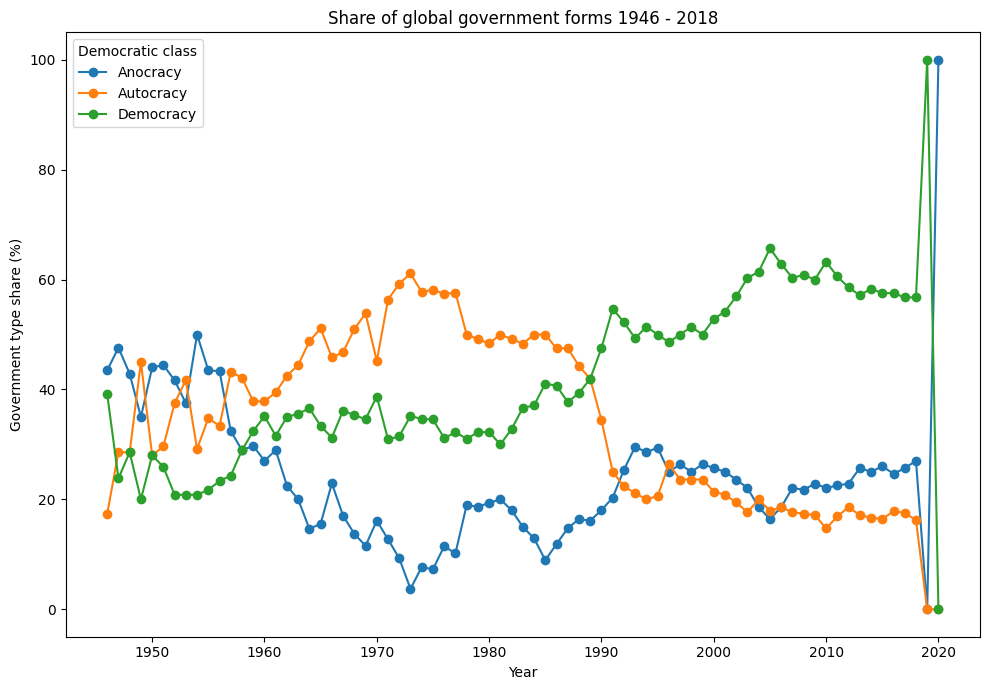

In [ ]:
import matplotlib.pyplot as plt

# Calculate the proportions
df_reset = df_dem.reset_index()
class_counts = df_reset.groupby(['year', 'democratic_class']).size().unstack(fill_value=0)
class_shares = class_counts.div(class_counts.sum(axis=1), axis=0) * 100 

# Generate the plot
plt.figure(figsize=(10, 7))
for class_label in class_shares.columns:
    plt.plot(class_shares.index, class_shares[class_label], marker='o', label=class_label)

plt.title('Share of global government forms 1946 - 2018')
plt.xlabel('Year')
plt.ylabel('Government type share (%)')
plt.legend(title='Democratic class')
plt.tight_layout()
plt.show()


Generate the plot for the quartiles of the Rule of Law index over the years

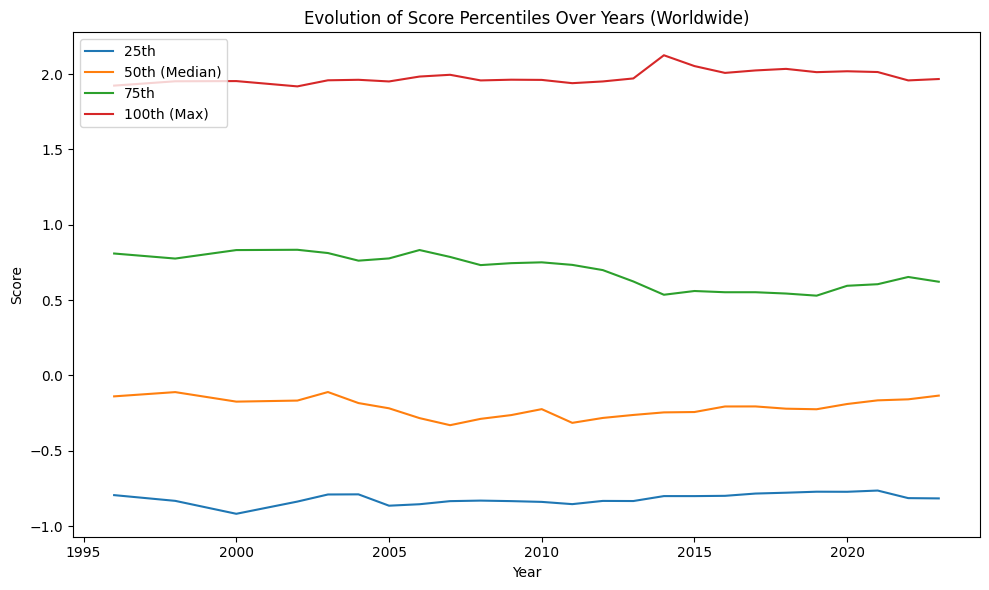

In [33]:
df_reset = df_rol.reset_index()

df_reset['score'] = pd.to_numeric(df_reset['score'], errors='coerce')

grouped = df_reset.groupby('year')['score']

q25 = grouped.quantile(0.25)
q50 = grouped.quantile(0.5)  
q75 = grouped.quantile(0.75)
q100 = grouped.max()  

plt.figure(figsize=(10, 6))
plt.plot(q25.index, q25.values, label='25th')
plt.plot(q50.index, q50.values, label='50th (Median)')
plt.plot(q75.index, q75.values, label='75th')
plt.plot(q100.index, q100.values, label='100th (Max)')
plt.xlabel('Year')
plt.ylabel('Score')
plt.title('Evolution of Score Percentiles Over Years (Worldwide)')
plt.legend()
plt.tight_layout()
plt.show()


<h2><center>Exploratory Data Analysis</center></h2>

For the EDA we start by computing the tfidf matrix over the whole speeches' dataset

In [34]:
from sklearn.feature_extraction.text import TfidfVectorizer
 
documents = df_clean["text_stemmed"].tolist()
 
vectorizer = TfidfVectorizer(norm='l2', use_idf=True, smooth_idf=True)
tfidf_matrix = vectorizer.fit_transform(documents)
tfidf_matrix
 

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 7874636 stored elements and shape (10952, 47642)>

We save this matrix into a dataframe to facilitate initial analysis

In [36]:
vocab = vectorizer.get_feature_names_out()
tfidf_matrix_df = pd.DataFrame.sparse.from_spmatrix(tfidf_matrix, columns = vocab)
tfidf_matrix_df.head()

,00,000,000million,000th,000yearlong,001,002,0024,003,00394,...,ш1ь1а,ьо1л,қарекет,қылмақ,יה,יר,ישראל,עם,קי,ﬂagrant
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


We match the index with our original speeches' index

In [37]:
tfidf_matrix_df.index = df_clean.index
tfidf_matrix_df.head()


,,00,000,000million,000th,000yearlong,001,002,0024,003,00394,...,ш1ь1а,ьо1л,қарекет,қылмақ,יה,יר,ישראל,עם,קי,ﬂagrant
speaker,year,,,,,,,,,,,,,,,,,,,,,
ARG,1946,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AUS,1946,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BEL,1946,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BLR,1946,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BOL,1946,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


We get the meaningful vocabulary from a dataset that was prepared by us with the stemmed words that are related to the scope of the research question. The generation of the list is not covered in this notebook but is covered in the report, it consisted of using the GloVe model to generate words similar to democracy and then twick them manually to better fit the needs of the question in hands

In [45]:
df_vocab = pd.read_csv(os.path.join("DATA","dem_vocab.csv"))
df_vocab.head()

,item
0,digniti
1,revolut
2,democrat
3,truth
4,faith


We start by getting the sum of the tfidf scores over all documents for each word

In [41]:
df_sum = pd.DataFrame([tfidf_matrix_df.sum()], columns=tfidf_matrix_df.columns)
df_sum

,00,000,000million,000th,000yearlong,001,002,0024,003,00394,...,ш1ь1а,ьо1л,қарекет,қылмақ,יה,יר,ישראל,עם,קי,ﬂagrant
0,0.291553,63.301823,0.03533,0.06646,0.054856,0.197264,0.083549,0.029291,0.160216,0.139793,...,0.039982,0.059695,0.064348,0.064348,0.028599,0.028599,0.028599,0.028599,0.028599,0.064465


We now pick the ones in our vocabulary

In [46]:
df_sum_list = df_sum[df_vocab.iloc[:,0]]
df_sum_list

,digniti,revolut,democrat,truth,faith,justic,happi,liberti,constitut,desir,...,capit,socialist,affair,govern,life,embrac,freedom,struggl,independ,commun
0,81.475423,49.681087,182.234596,41.822111,80.81843,143.014287,54.850818,33.031036,119.993872,95.364438,...,67.806643,58.589844,107.814924,446.901127,127.968837,29.130444,165.896401,132.806237,214.11408,350.445976


Now we can plot the most influential words over all documents

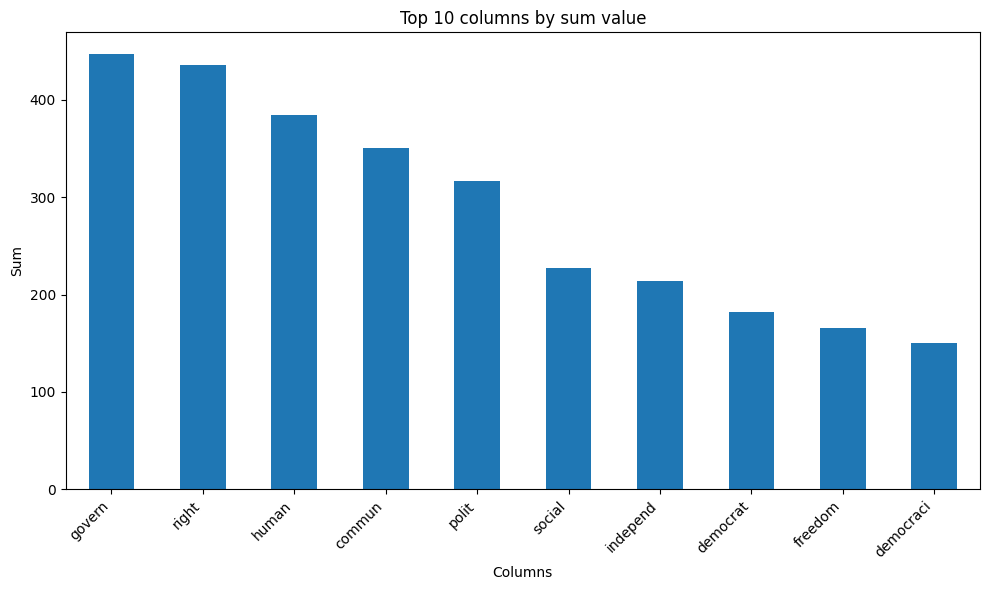

In [ ]:
# Pick the top 10 words
row = df_sum_list.iloc[0]
top10 = row.sort_values(ascending=False).head(10)

# Plot the result
plt.figure(figsize=(10,6))
top10.plot(kind='bar')
plt.title('Top 10 columns by sum value')
plt.ylabel('Sum')
plt.xlabel('Columns')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


We repeat the process for the whole tfidf matrix

In [48]:
tfidf_matrix_df
tfidf_matrix_df_list = tfidf_matrix_df[df_vocab.iloc[:,0]]
tfidf_matrix_df_list.head()

,,digniti,revolut,democrat,truth,faith,justic,happi,liberti,constitut,desir,...,capit,socialist,affair,govern,life,embrac,freedom,struggl,independ,commun
speaker,year,,,,,,,,,,,,,,,,,,,,,
ARG,1946,0.023435,0.017007,0.008687,0.129046,0.011432,0.035626,0.02883,0,0.018533,0.052435,...,0,0,0.009814,0.056319,0.008606,0.0183,0.03513,0,0.016421,0
AUS,1946,0,0,0.010719,0,0.028212,0,0,0,0.011434,0.01941,...,0,0,0.012109,0.034746,0.005309,0,0.016255,0,0,0.003955
BEL,1946,0,0,0,0,0.012536,0.048832,0,0,0.020323,0,...,0,0,0,0.07548,0,0,0,0,0,0.00703
BLR,1946,0.009195,0,0.054534,0,0.008971,0.013978,0,0,0,0.024688,...,0.009939,0.014301,0.007701,0.044194,0.006753,0,0.013783,0.008162,0.012886,0
BOL,1946,0,0,0.014563,0,0,0.014931,0.024165,0.09289,0.015535,0,...,0.021234,0,0,0.073432,0,0,0,0.017437,0,0


Now, to plot the tfidf evolution for the top 10 words in a meaningful way we calculate their scores normalized by the number of speakers in each year

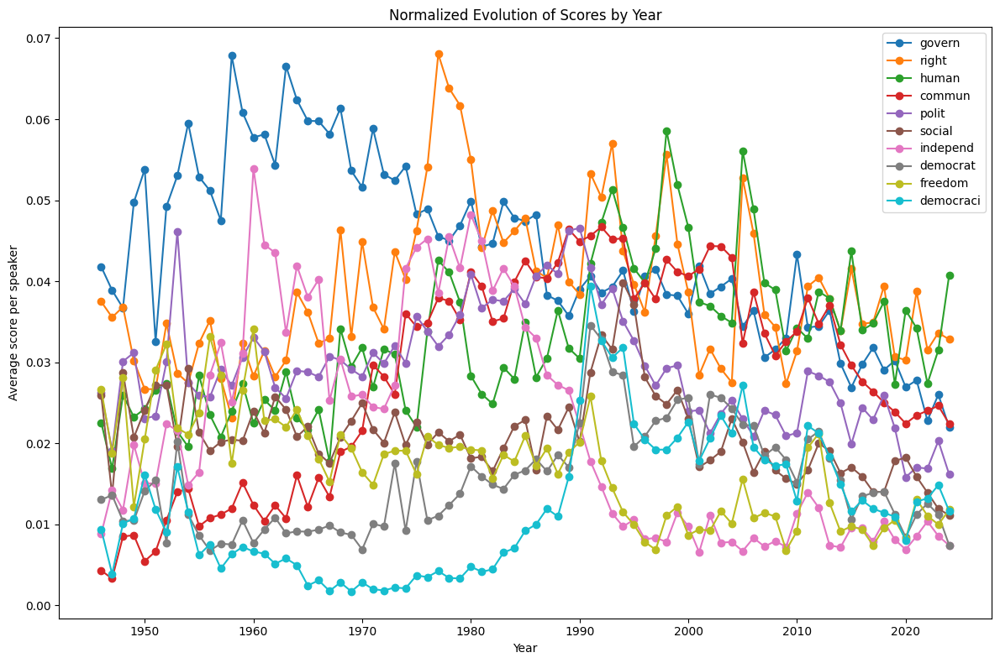

In [ ]:
# Reset index and grpip by year
df_reset = tfidf_matrix_df_list.reset_index()
df_reset['year'] = df_reset['year'].astype(int)

# Recover the top10 list
top10_cols = top10.index.tolist()

# Determine the tfidf score sum per year, number of speakers and normalization
sum_per_year = df_reset.groupby('year')[top10_cols].sum()
speaker_counts = df_reset.groupby('year')['speaker'].nunique()
normalized = sum_per_year.div(speaker_counts, axis=0)

# Plot results
plt.figure(figsize=(12, 8))
for col in top10_cols:
    plt.plot(normalized.index, normalized[col], marker='o', label=col)

plt.xlabel('Year')
plt.ylabel('Average score per speaker')
plt.title('Normalized Evolution of Scores by Year')
plt.legend()
plt.tight_layout()
plt.show()


We can now merge the democratic class into the tfidf matrix df

In [55]:
df_dem_tfidf = pd.merge(tfidf_matrix_df_list, df_dem, right_index=True, left_index=True, how="inner")
df_dem_tfidf.dropna(inplace=True)
df_dem_tfidf.head()

,,digniti,revolut,democrat,truth,faith,justic,happi,liberti,constitut,desir,...,affair,govern,life,embrac,freedom,struggl,independ,commun,polity,democratic_class
speaker,year,,,,,,,,,,,,,,,,,,,,,
AUS,1946,0,0,0.010719,0,0.028212,0,0,0,0.011434,0.01941,...,0.012109,0.034746,0.005309,0,0.016255,0,0,0.003955,10,Democracy
BEL,1946,0,0,0,0,0.012536,0.048832,0,0,0.020323,0,...,0,0.07548,0,0,0,0,0,0.00703,8,Democracy
BOL,1946,0,0,0.014563,0,0,0.014931,0.024165,0.09289,0.015535,0,...,0,0.073432,0,0,0,0.017437,0,0,-5,Anocracy
BRA,1946,0,0,0.017119,0,0.022529,0.017552,0.028408,0.072799,0,0.062001,...,0,0.012332,0,0,0,0.020498,0,0.012634,7,Democracy
CAN,1946,0,0,0,0,0,0.031552,0,0,0.016414,0.018576,...,0,0.033253,0.015244,0,0,0,0,0,10,Democracy


We make a plot of the most important words for each class over all years

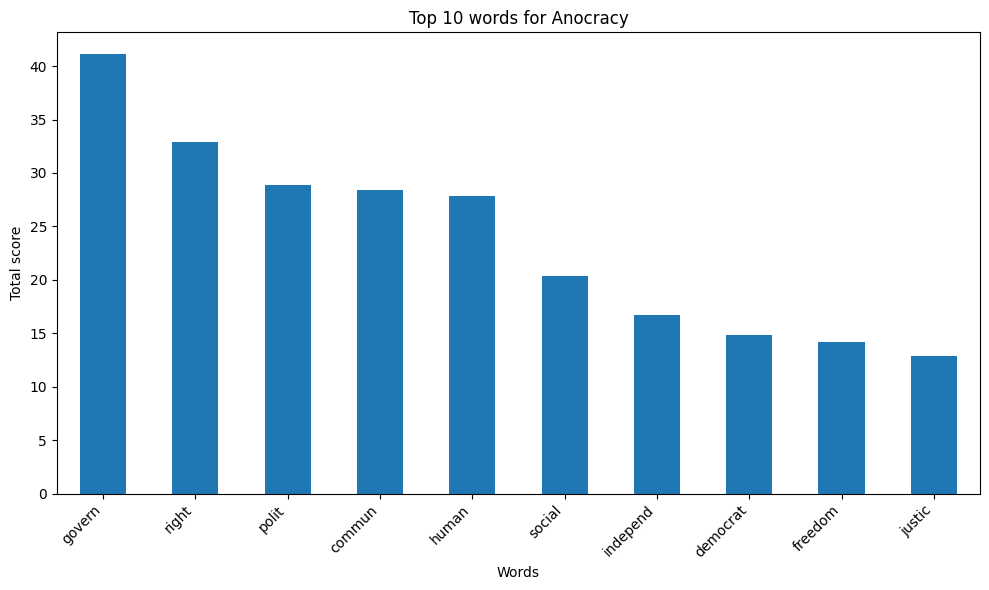

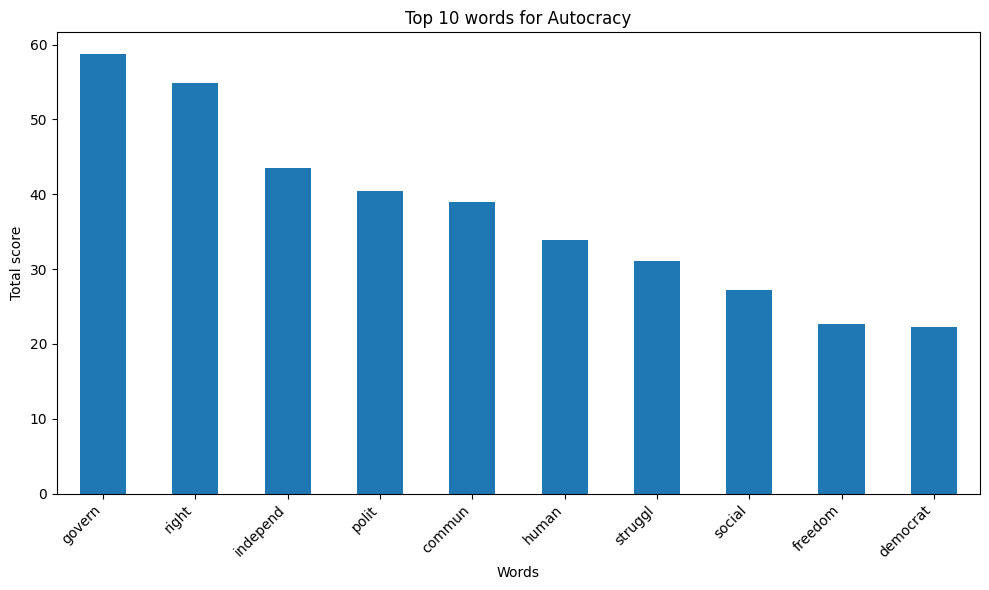

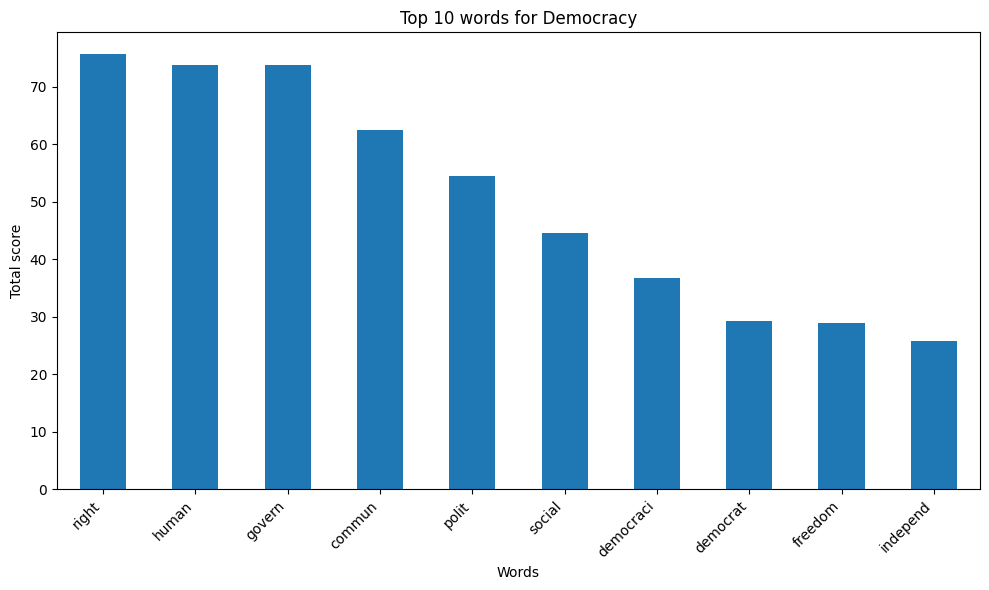

In [ ]:
# Recover the full word list
word_list = df_vocab["item"].tolist()

# Group by democratic class
grouped = df_dem_tfidf.groupby('democratic_class')[word_list].sum()

# For each class sum the total value of each of the words and plot the top 10
for cls in grouped.index:
    top10 = grouped.loc[cls].sort_values(ascending=False).head(10)
    plt.figure(figsize=(10, 6))
    top10.plot(kind='bar')
    plt.title(f'Top 10 words for {cls}')
    plt.ylabel('Total score')
    plt.xlabel('Words')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()


To finalize the EDA we will try to find if the TFIDF vectorization shows a relation with the other 2 datasets. We begin by recomputing the tfidf for the selection of documents that corresponds to each dataset

In [62]:
df_reset = df_clean.loc[df_dem.index,"text_stemmed"]
df_reset.head()

speaker  year
AFG      1952    consid great honour privileg share opportun re...
         1957    privileg express mr. presid congratul afghanis...
         1958    138. use opportun make statement behalf govern...
         1959    69. speak small countri afghanistan enjoy frie...
         1960    outset mr. presid allow extend sincer congratu...
Name: text_stemmed, dtype: object

In [73]:
tfidf_dem = vectorizer.fit_transform(df_reset.tolist())
tfidf_dem

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 2999192 stored elements and shape (3992, 31107)>

Once we have the new tfidf we can now compute its projection on the 2D plane

In [74]:
from scipy.sparse import load_npz
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt


pca = PCA(n_components=2)
pca_result = pca.fit_transform(tfidf_dem.toarray())


With the computed projection we can now make a scatter plot with each point colored according to regime class

C:\Users\jtfb7\AppData\Local\Temp\ipykernel_12452\3646812835.py:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', len(labels))


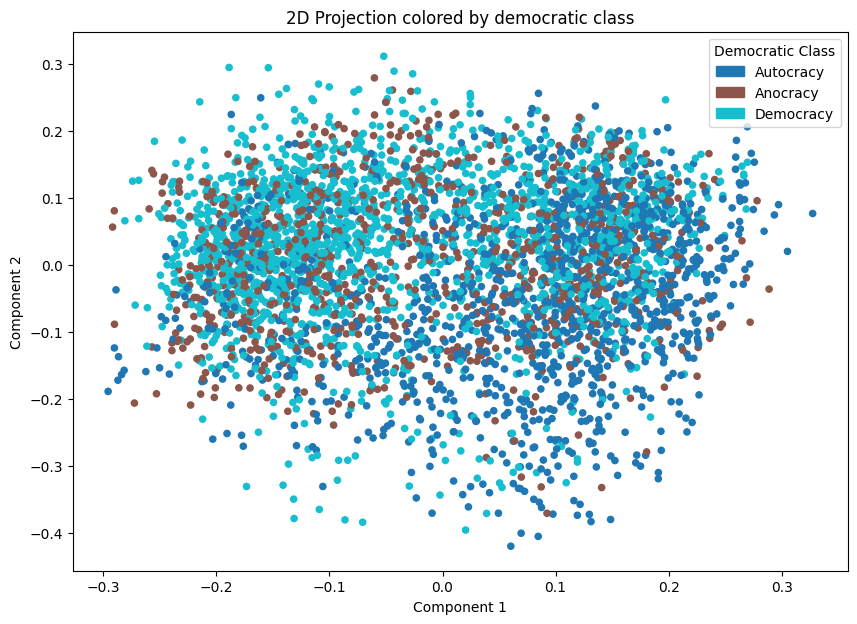

In [ ]:
import matplotlib.patches as mpatches
import matplotlib.cm as cm
import matplotlib.colors as mcolors

# Create labels from different regimes as colors
labels = df_dem["democratic_class"].unique()
label_to_int = {label: i for i, label in enumerate(labels)}
colors = df_dem["democratic_class"].map(label_to_int)
cmap = cm.get_cmap('tab10', len(labels))  
norm = mcolors.BoundaryNorm(range(len(labels)+1), cmap.N)

# Plot the points resulting from projection
plt.figure(figsize=(10, 7))
scatter = plt.scatter(
    pca_result[:, 0], 
    pca_result[:, 1], 
    c=colors, 
    cmap=cmap, 
    norm=norm, 
    s=20
)

# Add plot details like legend
legend_handles = [
    mpatches.Patch(color=cmap(label_to_int[label]), label=label) 
    for label in labels
]

plt.legend(handles=legend_handles, title="Democratic Class")
plt.title("2D Projection colored by democratic class")
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.show()


Now we repeat the process for the cross between the speeches df and the Rule of Law df

In [76]:
df_reset = df_clean.loc[df_rol.index,"text_stemmed"]
df_reset.head()

speaker  year
AFG      1996    ﻿at outset allow sir express deleg ’ congratul...
ALB      1996    ﻿let begin express warmest congratul mr. razal...
DZA      1996    ﻿the current session unit nation gener assembl...
AND      1996    ﻿allow first express honour feel andorran dist...
AGO      1996    ﻿allow outset congratul mr. ismail razali elec...
Name: text_stemmed, dtype: object

In [77]:
tfidf_rol = vectorizer.fit_transform(df_reset.tolist())
tfidf_rol

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 2704678 stored elements and shape (4735, 26193)>

In [78]:
pca_result = pca.fit_transform(tfidf_rol.toarray())

With the projection we can make a new plot, since this df corresponds to a continuous index and not a regression the points are aggregated by a heat map coloring

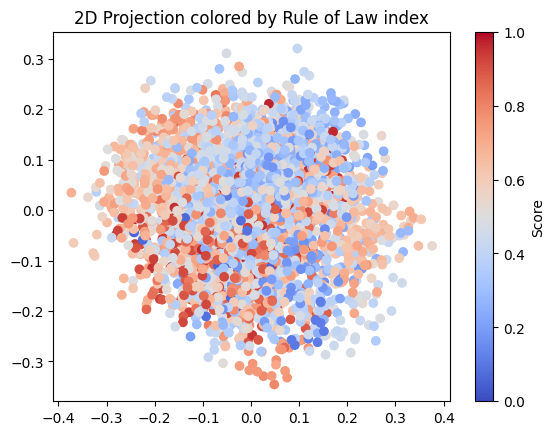

In [ ]:
# Extract the plottinh points 
x, y = pca_result[:, 0], pca_result[:, 1]
z = df_rol["score"].values.astype(float)
z = (z - z.min()) / (z.max() - z.min())

# Scatter plot
plt.scatter(x, y, c=z, cmap="coolwarm")  
plt.colorbar(label="Score")
plt.title("2D Projection colored by Rule of Law index")
plt.show()


Additionally, to compute some sort of relation between the democratic index and the rule of law index we will merge the 2 dataframes on the common points

In [ ]:
df_reset = pd.merge(df_dem,df_rol,right_index=True,left_index=True,how="inner")
df_reset["score"] = df_reset["score"].values.astype(float)
df_reset

polity democratic_class              score
speaker year                                            
AFG     1996      -7        Autocracy  -1.78807544708252
        1998      -7        Autocracy  -1.73488676548004
        2000      -7        Autocracy  -1.78066074848175
        2014      -1         Anocracy   -1.4377019405365
        2015      -1         Anocracy  -1.51620066165924
...              ...              ...                ...
YEM     2009      -2         Anocracy   -1.0932948589325
        2010      -2         Anocracy  -1.09233939647675
        2011      -2         Anocracy          -1.291892
        2012       3         Anocracy          -1.277678
        2013       3         Anocracy          -1.186856

[1415 rows x 3 columns]

We can plot the boxplot split by classes for analysis

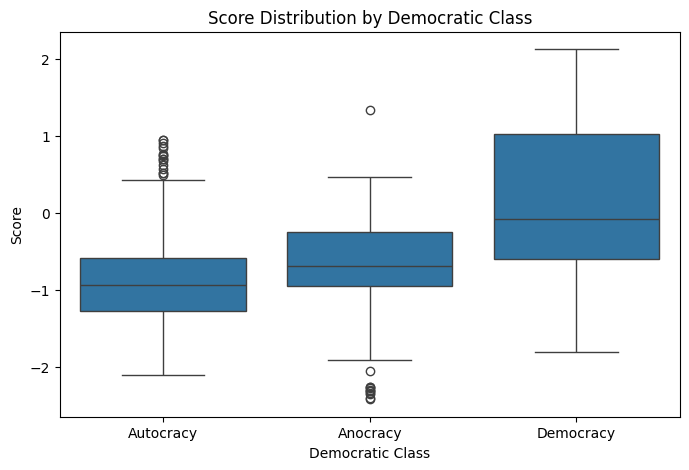

In [89]:
import seaborn as sns

plt.figure(figsize=(8, 5))
sns.boxplot(x='democratic_class', y='score', data=df_reset)
plt.title('Score Distribution by Democratic Class')
plt.xlabel('Democratic Class')
plt.ylabel('Score')
plt.show()


We can also plot a scatter of democratic index vs rule of law index and fit a regression

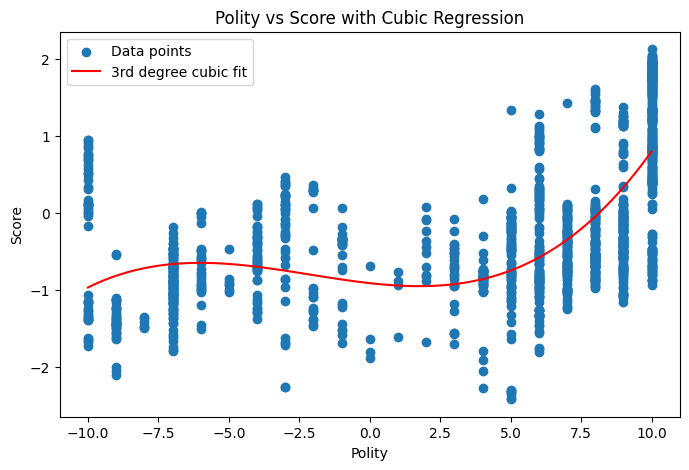

In [ ]:
from numpy.polynomial.polynomial import Polynomial

# Retreive the variables for scatter and fit
x = df_reset['polity']
y = df_reset['score']

# Fit a cubic regression and recover coeficients
coefs = Polynomial.fit(x, y, 3).convert().coef

# Get the points for the plot
x_line = np.linspace(x.min(), x.max(), 100)
y_line = coefs[0] + coefs[1]*x_line + coefs[2]*x_line**2 + coefs[3]*x_line**3

# Plot
plt.figure(figsize=(8, 5))
plt.scatter(x, y, label='Data points')
plt.plot(x_line, y_line, color='red', label='3rd degree cubic fit')
plt.title('Polity vs Score with Cubic Regression')
plt.xlabel('Polity')
plt.ylabel('Score')
plt.legend()
plt.show()


<h2><center>Model</center></h2>

For the model we recover the df that merges the speeches with the democratic classes

In [92]:
df_reset = df_dem_speech
df_reset.head()

,,session,text,cleaned_text,text_no_stopwords,text_stemmed,polity,democratic_class
speaker,year,,,,,,,
AUS,1946,1,the general assembly of the united nations is ...,the general assembly of the united nations is ...,general assembly united nations meeting time h...,gener assembl unit nation meet time hospit cit...,10,Democracy
BEL,1946,1,the\tprincipal organs of the united nations ha...,the principal organs of the united nations hav...,principal organs united nations functioning ne...,princip organ unit nation function nearli nine...,8,Democracy
BOL,1946,1,coming to this platform where so many distingu...,coming to this platform where so many distingu...,coming platform many distinguished eloquent sp...,come platform mani distinguish eloqu speaker p...,-5,Anocracy
BRA,1946,1,i would first like to express to the city of n...,i would first like to express to the city of n...,would first like express city new york behalf ...,would first like express citi new york behalf ...,7,Democracy
CAN,1946,1,"if were not anxious, like all my colleagues, ...",if were not anxious like all my colleagues to ...,anxious like colleagues take consideration imp...,anxiou like colleagu take consider import sugg...,10,Democracy


We define the inpus and the output to train the classifier

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix

# Make all cores available
n_jobs = -1 
random_state = 42

texts = df_reset['text_stemmed'].tolist()
y = df_reset['democratic_class'].to_numpy(dtype=str)

We define the pipeline, with calculating the tfidf as the first step before fitting a model or making a prediction. Multiple models were experimented, KNN is the one that yielded the best results so is the one that comes in the notebook presentation. The others are not represented due to redunduncy, but essentially they depend in the change of the grid search parameters and the model in the pipeline

In [ ]:
# Define the pipeline based on the model
pipe = Pipeline([
    ('tfidf', TfidfVectorizer()),
    ('knn', KNeighborsClassifier()) 
])

# Set the grid parameters and values for the search
param_grid_knn = {
    'knn__n_neighbors': [5, 10, 20, 30],
    'knn__weights': ['uniform', 'distance']}

# Split the data in training and test
texts_train, texts_test, y_train, y_test = train_test_split(
    texts, y, test_size=0.2, random_state=random_state, stratify=y)

# Setup a K-fold method
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=random_state)

# Define the grid with the defined variables
grid = GridSearchCV(
    pipe,
    param_grid=param_grid_knn,
    scoring='f1_weighted',
    cv=cv,
    n_jobs=n_jobs,
    verbose=1)

Fit the model

In [ ]:
print('Running grid search...')
grid.fit(texts_train, y_train)

print('\nBest params:', grid.best_params_)
print('Best CV f1_weighted:', round(grid.best_score_, 4))


From the grid search we get the best parameters, we can now make a prediction on the testing set and evaluate our fit

In [ ]:
best_model = grid.best_estimator_

y_pred = best_model.predict(texts_test)

print('\nTest Accuracy:', round(accuracy_score(y_test, y_pred), 4))
print('Test F1 (weighted):', round(f1_score(y_test, y_pred, average='weighted'), 4))
print('\nClassification report:\n')
print(classification_report(y_test, y_pred))

As a visual evaluation we can add a confusion matrix

In [ ]:
labels_sorted = sorted(pd.unique(y))
cm = confusion_matrix(y_test, y_pred, labels=labels_sorted)

fig, ax = plt.subplots(figsize=(6,5))
ax.set_title(f"Confusion Matrix (Logistic regression) – C={grid.best_params_['logreg__C']}, "
             f"weight={grid.best_params_['logreg__class_weight']}, "
             f"penalty={grid.best_params_['logreg__penalty']}")
ax.set_ylabel('Actual')
ax.set_xticks(np.arange(len(labels_sorted)))
ax.set_yticks(np.arange(len(labels_sorted)))
ax.set_xticklabels(labels_sorted, rotation=45, ha="right")
ax.set_yticklabels(labels_sorted)
im = ax.imshow(cm, interpolation='nearest')

for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        ax.text(j, i, str(cm[i, j]), ha='center', va='center')

fig.tight_layout()
fig.savefig(os.path.join("..", "DATA", "Figures", "log_reg_grid.pdf"), dpi=600, bbox_inches='tight')
print('Saved plot: confusion_matrix.png')